# EDA project - Andrea Schrader

__Dataset:__ "King County House Data" on home sales in King County (USA)<br>
<br>
__Stakeholder choice__<br>
    * Person chosen: Erin Robinson<br>
    * Stakeholder type: Buyer<br>
    * Stakeholder Description: Invest in poor neighborhood, buying & selling, costs back + little profit, socially responsible.<br>
<br>
___Overarching topic focussed on in this analysis:___<br>
Insights from multi-sale houses in King County as compared to single-sale houses for both: financial and social gain.<br>
__Assumption__<br>
    * The dataset is representative for other years as well. In the real world I would not base suggestions on a dataset which comprises one year only although the number of data points is high.<br>
    * Poor neighborhoods are more likely locates around buildings with low prices.<br>
    * People with financial problems are more likely to sell houses within a short time frame or speculants are acting within short time frames and are competitors for such houses.<br>
    * Renovating houses in such areas or these already identified or even houses predicted to match that pattern leaves a positive social footprint especially when sticking roughly to the current prices of the market.<br>
<br>
__Questions__<br>
>___1) Where are most houses with low prices located?___<br>
> * Hypothesis: The further apart from the city center or in a specific area of the city, cheaper houses will cluster as well as in regions not so eat the far outskirt of the city.<br>
> * Answer: In the outer areas of the city, especially in the south and not at the water.

>___2) How much money can be spent for renovations in comparably poor areas to ensure that costs are refunded and a little profit is achieved based according to the data?___<br>
>* Hypothesis: Houses that were sold again within one year are among the cheaper, smaller and older houses.<br>
>* Answer: Most parts of the hypothesis are true. While the area for living was indeed smaller and multi-sale houses had less floors, the area of the lot was surprisingly larger. this implies that there might also be more room for extending the living area if allowed.

> ___3) Are there additional risks due to the condition of these houses and can these be overcome by renovations?___<br>
> * Hypothesis: These houses are in a comparably lower quality category and less renovations were conducted.<br>
> * The quality of these houses is comparable to the median of the single-sale houses.
> * With respect to the number of renovations conducted, the hypotheses is also not supported by the data. However, the dataset is small for renovations and errors might have occurred for the "0" values. One might consider to asl those collecting the data or, if not accessible,to suggest to conduct a new survey focussing on this aspect in case a stakeholder requests more secure recommendations based on this feature.


___Should the class of multi-sale houses be kept in analysis pipelines in the future?___

YES, this class of houses can be recommended to the stakeholder and can be used for future predictions for similar strategies.

---

## Documentation of the analysis conducted - May, 10th-12th 2022



In [1]:
# First I import the recommended packages and change some options for plotting according to the suggestions

import warnings
warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from matplotlib.ticker import PercentFormatter
plt.rcParams.update({ "figure.figsize" : (8, 5),"axes.facecolor" : "white", "axes.edgecolor":  "black"})     # setting the figure size and some colors for matplotlib plots including axes
plt.rcParams["figure.facecolor"]= "w"
pd.plotting.register_matplotlib_converters()
pd.set_option('display.float_format', lambda x: '%.3f' % x)                                                  # change the decimal numbers to 3 for the displayed float format of panda DataFrames

# Reading in the data and first geographic exploration

In [2]:
# Reading in the data (kd = "King county house Data")
kd = pd.read_csv('./data/King_County_House_prices_dataset.csv')
# Get an idea about the geographic data (columns "lat" and "long" for the coordinates and "zip" for the zip code) and price data (column "price" [$]) for the first plot below. Are there NaN entries? Are the min and max values unusual?
kd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     19221 non-null  float64
 9   view           21534 non-null  float64
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  object 
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   17755 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

# Units of the given coordinates:


<img style = "float: left;" src="https://upload.wikimedia.org/wikipedia/commons/thumb/8/83/Latitude_and_longitude_graticule_on_a_sphere.svg/600px-Latitude_and_longitude_graticule_on_a_sphere.svg.png" alt="globe_coordinates" width="200"/>
 <br>
 As no units are given neither in the column names nor in the description, I derive the format from knowing in which region the houses are located and from classical descriptions of such coordinates in the geographic coordinate system (GCS):<br>

 * This is an example for a (lat,long) tupel: (φ,λ) = (47.5112, -122.257) presumably in decimal degrees (DD) [°]
 <br>
 <br>
 <br>
 <br>
 <br>
Left: "Diagram of the latitude (φ) and longitude (λ) angle measurements in the GCS." from https://en.wikipedia.org/wiki/Geographic_coordinate_system.


In [3]:
# Conducting an initial geo plot to visualize the area of interest
# The color indicates the year of renovation and we see immediately that there is either no data available for this feature or there was no renovation.
# The first map gives us an idea about the topology of the region.
# scatter_mapbox
fig = px.scatter_mapbox(kd, lat="lat", lon="long",
                        color='yr_renovated', 
                        #opacity=0.9,
                        color_continuous_scale=px.colors.sequential.Viridis, 
                        #hover_name="yr_renovated",
                        #size='condition',
                        size_max=7,
                        zoom=8,
                        height=800)
fig.update_layout(mapbox_style="stamen-terrain")
#fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.show()
# "open-street-map", "carto-positron", "carto-darkmatter", "stamen-terrain", "stamen-toner" or "stamen-watercolor"

# A first code for this was shared by Ryan North in our daily review.

In [4]:
# A similar plot with open-street map, now the color indicates price as the target variable
# without log2
# scatter_mapbox
fig = px.scatter_mapbox(kd, lat="lat", lon="long",
                        color='price', 
                        #opacity=0.9,
                        color_continuous_scale=px.colors.sequential.Greys_r, 
                        #hover_name="yr_renovated",
                        #size='condition',
                        size_max=7,
                        zoom=8,
                        height=800)
fig.update_layout(mapbox_style="open-street-map")
#fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.show()
# "open-street-map", "carto-positron", "carto-darkmatter", "stamen-terrain", "stamen-toner" or "stamen-watercolor"

In [5]:
# A similar plot with open-street map, now the color indicates price as the target variable
# with log2, for this the log of prices is added as a column "log_prices"
kd['log_price'] = np.log2(kd['price']).tolist()
# scatter_mapbox
fig = px.scatter_mapbox(kd, lat="lat", lon="long",
                        color='log_price', 
                        #opacity=0.9,
                        color_continuous_scale=px.colors.sequential.Greys_r, 
                        #hover_name="yr_renovated",
                        #size='condition',
                        size_max=7,
                        zoom=8,
                        height=800)
fig.update_layout(mapbox_style="open-street-map")
#fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.show()
# "open-street-map", "carto-positron", "carto-darkmatter", "stamen-terrain", "stamen-toner" or "stamen-watercolor"

# Conclusions from the last three plots: 
The data set is very dense. However, only few houses have been renovated. For many houses this information is missing. The value "0" is given for most houses according to hovering over the map (see also some printed text statements below within this notebook). Houses in the south and in the hills are cheaper than those in the north. Houses in Bellevue and on Mercer Island are most expensive. Visualizing log2(prices) improves the visualization and allow for direct insights!

### What is the timespan during which the documented house sales occured?

In [6]:
# First inspection of the data 
# kd.shape
# kd.head()
# kd.tail()
#kd.info()
kd.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,log_price
count,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,19221.000,21534.000,21597.000,21597.000,21597.000,21597.000,17755.000,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000
mean,4580474287.771,540296.574,3.373,2.116,2080.322,15099.409,1.494,0.008,0.234,3.410,7.658,1788.597,1971.000,83.637,98077.952,47.560,-122.214,1986.620,12758.284,18.825
std,2876735715.748,367368.140,0.926,0.769,918.106,41412.637,0.540,0.087,0.766,0.651,1.173,827.760,29.375,399.946,53.513,0.139,0.141,685.230,27274.442,0.760
min,1000102.000,78000.000,1.000,0.500,370.000,520.000,1.000,0.000,0.000,1.000,3.000,370.000,1900.000,0.000,98001.000,47.156,-122.519,399.000,651.000,16.251
25%,2123049175.000,322000.000,3.000,1.750,1430.000,5040.000,1.000,0.000,0.000,3.000,7.000,1190.000,1951.000,0.000,98033.000,47.471,-122.328,1490.000,5100.000,18.297
50%,3904930410.000,450000.000,3.000,2.250,1910.000,7618.000,1.500,0.000,0.000,3.000,7.000,1560.000,1975.000,0.000,98065.000,47.572,-122.231,1840.000,7620.000,18.780
75%,7308900490.000,645000.000,4.000,2.500,2550.000,10685.000,2.000,0.000,0.000,4.000,8.000,2210.000,1997.000,0.000,98118.000,47.678,-122.125,2360.000,10083.000,19.299
max,9900000190.000,7700000.000,33.000,8.000,13540.000,1651359.000,3.500,1.000,4.000,5.000,13.000,9410.000,2015.000,2015.000,98199.000,47.778,-121.315,6210.000,871200.000,22.876


In [8]:
# This chunck of code provides the number of unique values or entries per column
kd_nunique = []
for i in range(0,(kd.shape[1])):
    kd_nunique = kd_nunique + [kd.iloc[:,i].nunique()]
kd_nunique = pd.DataFrame(zip(kd.columns.to_list(), kd_nunique))
print(kd.shape)
print(kd_nunique)



(21597, 22)
                0      1
0              id  21420
1            date    372
2           price   3622
3        bedrooms     12
4       bathrooms     29
5     sqft_living   1034
6        sqft_lot   9776
7          floors      6
8      waterfront      2
9            view      5
10      condition      5
11          grade     11
12     sqft_above    942
13  sqft_basement    304
14       yr_built    116
15   yr_renovated     70
16        zipcode     70
17            lat   5033
18           long    751
19  sqft_living15    777
20     sqft_lot15   8682
21      log_price   3622


### First inspection of the data structure and first ideas for an EDA of the class of "multi_sale houses"

Please note: this notebook was iteratively extended. The EDA-analysis started here, however, the story for the stakeholder started with the extensions above.

1. What is the shape? - 21597 rows and 21 columns
    - 21597 home sales and 19 features, one home id and one price per sale
    - 18  numeric data features (int64 or float64)
    - 2   categorical data features (object)
    - target variable: price
    - features: 
        * id, date
        * bedrooms, bathrooms, floors
        * sqft_living, sqft_lot, sqft_above, sqft_basement, sqft_living15, sqft_lot15
        * waterfront, view, zipcode, lat, long
        * condition, grade, yr_built, yr_renovated

2. Are there houses which are sold several times within the acquisition period?
    - should only be recommended to buyers if there was an average gain when sold for the second time.
    - other aspects of these houses need to be carefully inspected
    - what are indicators to identify such houses on the current market (area, building year, price etc.)
    - can be used to asses effects of renovation
    - might be indicators of a poor neighborhood, with a sufficient gain and renovation this could have some social benefit along the financial gain for the buyer.
    - might be worth a a short time investment for specific stakeholders. -> This can be tested using the unique method.
    - example histories of multiple sales houses could be generated if n is not too low.

3. What is the date range?
    - 02-05-2014 - 27-05-2015

In [9]:
# This is a new chunk of code added late to add the id_count to the master table.
# Count the occurences of ids
kd_id = pd.DataFrame(kd.id.value_counts())
# Give a meaningfull name to the result column
kd_id.columns = ['id_counts']

# Create a dataframe from ids and id_counts
kd_id_DF = pd.DataFrame({'id': kd_id.index.tolist(), 'id_counts': kd_id['id_counts'].reset_index().iloc[:,1]})

# Join with kd_id
kd =kd.set_index('id', drop=False).join(kd_id)



In [10]:
# Are there homes which were sold more than twice within one year and if yes how often were these sold?

# Count the occurences of ids
kd_id = pd.DataFrame(kd.id.value_counts())
# Give a meaningfull name to the result column
kd_id.columns = ['id_counts']

# To use the main table for subsetting the data, the index is adjusted to the id column entries and the id column is preserved: 
kd_multi = kd.set_index('id', drop=False )

# I only kept rows for homes with at least two ids:
kd_multi = kd_multi[kd_id['id_counts']>1]
kd_sold_more_than_twice = kd_id[kd_id['id_counts']>2]

print(f"There are {len(kd_multi['id'].unique())} homes which were sold at least twice in 2014-2015.")

# Print the answer to the question in this cell:
if len(kd_sold_more_than_twice) == 1:
   print(f"{len(kd_sold_more_than_twice)} home was sold more than twice. The id of this homes is {kd_sold_more_than_twice.index.tolist()[0]}.")
else:
    print(f"{len(kd_sold_more_than_twice)} homes were sold more than twice. The list of ids of these homes is: {kd_sold_more_than_twice.index.tolist()[:]}.")


There are 176 homes which were sold at least twice in 2014-2015.
1 home was sold more than twice. The id of this homes is 795000620.


In [11]:
print(f"There are {len(kd_multi['id'].unique())} multi-sale houses.")
#Was any of these homes renovated after 2013? 
for year in kd_multi[kd_multi['yr_renovated']>0]['yr_renovated']:
    if year > 2013:
        print(f"Yes, id {kd_multi[kd_multi['yr_renovated'] == year]['id']} was renovated after 2013")
        break
    else:
        continue
print("No, none of these homes was renovated in 2014 or 2015.")

#Was any of these homes renovated between 2008 and 2014?
for year in kd_multi[kd_multi['yr_renovated']>0]['yr_renovated']:
    if 2008 < year < 2013:
        print(f"Yes, id {kd_multi[kd_multi['yr_renovated'] == year]['id']} was renovated between 2008 and 2014.")
        break
    else:
        continue
print("No, none of these homes was renovated between 2008 and 2014.")

#Was any of these homes renovated between 1994 and 2009?
for year in kd_multi[kd_multi['yr_renovated']>0]['yr_renovated']:
    if 1994 < year < 2009:
        print(f"Yes, id {kd_multi[kd_multi['yr_renovated'] == year]['id']} was renovated between 1994 and 2009.")
        break
    else:
        continue
print("No, none of these homes was renovated between 1994 and 2009.")

# Is there a lot of missing data?
print(f"For {kd_multi['yr_renovated'].isnull().sum()} homes there is no information available on renovations.")
print(f"Only for {int((kd_multi['yr_renovated']>0).sum()/2)} homes there is information other than '0' available on renovations.")

print(f"The latest renovation of these houses was in {int(kd_multi['yr_renovated'].max())}.")
len(kd_multi['yr_renovated'].value_counts()>0)

kd_multi[kd_multi['yr_renovated']>0]


There are 176 multi-sale houses.
No, none of these homes was renovated in 2014 or 2015.
No, none of these homes was renovated between 2008 and 2014.
No, none of these homes was renovated between 1994 and 2009.
For 67 homes there is no information available on renovations.
Only for 4 homes there is information other than '0' available on renovations.
The latest renovation of these houses was in 1990.


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,log_price,id_counts
id,,,,,,,,,,,,,,,,,,,,,
1721801010,1721801010,9/3/2014,225000.000,3,1.000,1790,6120,1.000,0.000,0.000,...,0.0,1937,1964.000,98146,47.508,-122.337,830,6120,17.780,2
1721801010,1721801010,4/24/2015,302100.000,3,1.000,1790,6120,1.000,0.000,0.000,...,0.0,1937,1964.000,98146,47.508,-122.337,830,6120,18.205,2
1825069031,1825069031,8/14/2014,550000.000,4,1.750,2410,8447,2.000,0.000,3.000,...,350.0,1936,1980.000,98074,47.650,-122.088,2520,14789,19.069,2
1825069031,1825069031,10/16/2014,550000.000,4,1.750,2410,8447,2.000,NaN,3.000,...,350.0,1936,1980.000,98074,47.650,-122.088,2520,14789,19.069,2
7520000520,7520000520,9/5/2014,232000.000,2,1.000,1240,12092,1.000,NaN,0.000,...,280.0,1922,1984.000,98146,47.496,-122.352,1820,7460,17.824,2
7520000520,7520000520,3/11/2015,240500.000,2,1.000,1240,12092,1.000,0.000,0.000,...,280.0,1922,1984.000,98146,47.496,-122.352,1820,7460,17.876,2
8820903380,8820903380,7/28/2014,452000.000,6,2.250,2660,13579,2.000,0.000,0.000,...,0.0,1937,1990.000,98125,47.714,-122.286,1120,8242,18.786,2
8820903380,8820903380,1/2/2015,730000.000,6,2.250,2660,13579,2.000,0.000,0.000,...,0.0,1937,1990.000,98125,47.714,-122.286,1120,8242,19.478,2


Only 4 houses out of (176-67) houses were renovated for the multi-sale houses. This corresponds to a ratio of 4/(176-64)=0.03571428571428571. About 1 out of 25 houses with information on renovation has been renovated.

In [12]:
kd_single = kd.set_index('id', drop=False )
kd_single.drop(kd_multi['id'], inplace=True, axis=0)
#kd_multi['id'].unique().tolist()
kd_single.shape

(21244, 23)

In [13]:
#What about the single-sale houses?
print(f"There are {len(kd_single['id'].unique())} single-sale houses.")
#Was any of these homes renovated after 2013? 
x = 0
for year in kd_single[kd_single['yr_renovated']>0]['yr_renovated']:
    if year > 2013:
        print(f"Yes, {len(kd_single[kd_single['yr_renovated'] > year]['id'].unique())} houses were renovated after 2013.")
        y=len(kd_single[kd_single['yr_renovated'] > year]['id']) * -1
        x = 1
        break
    else:
        continue
if not x==1:
    print("No, none of these homes was renovated in 2014 or 2015.")

#Was any of these homes renovated between 2008 and 2014?
x=0
for year in kd_single[kd_single['yr_renovated']>0]['yr_renovated']:
    if 2008 < year < 2014:
        print(f"Yes, {len(kd_single[kd_single['yr_renovated'] > year]['id'].unique())+y} houses were renovated between 2008 and 2014.")
        z=(len(kd_single[kd_single['yr_renovated'] > year]['id'])+y)*-1
        x=1
        break
    else:
        continue
if not x==1:
    print("No, none of these homes was renovated between 2008 and 2014.")

#Was any of these homes renovated between 1994 and 2009?
x=0
for year in kd_single[kd_single['yr_renovated']>0]['yr_renovated']:
    if 1994 < year < 2009:
        print(f"Yes, {len(kd_single[kd_single['yr_renovated'] > year]['id'].unique())+z} houses were renovated between 1994 and 2009.\n{len(kd_single[kd_single['yr_renovated'] > year]['id'].unique())} houses were renovated in the last 20 years")
        x=1
        break
    else:
        continue
if not x==1:
    print("No, none of these homes was renovated between 1994 and 2009.")

# Is there a lot of missing data?
print(f"For {kd_single['yr_renovated'].isnull().sum()} houses, there is no information available on renovations.")
# as all sales are per one house only (single) we do not have to devide by 2
print(f"Only for {int((kd_single['yr_renovated']>0).sum())} houses, there is meaningful information (other than '0' and NaN) available on renovations. These can be considered as houses with renovation.")

print(f"The latest renovation of these houses was in {int(kd_single['yr_renovated'].max())}.")
len(kd_single['yr_renovated'].value_counts()>0)

kd_single[kd_single['yr_renovated']>0]

There are 21244 single-sale houses.
Yes, 14 houses were renovated after 2013.
Yes, 73 houses were renovated between 2008 and 2014.
Yes, 262 houses were renovated between 1994 and 2009.
335 houses were renovated in the last 20 years
For 3775 houses, there is no information available on renovations.
Only for 736 houses, there is meaningful information (other than '0' and NaN) available on renovations. These can be considered as houses with renovation.
The latest renovation of these houses was in 2015.


,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,log_price,id_counts
id,,,,,,,,,,,,,,,,,,,,,
3600057,3600057,3/19/2015,402500.000,4,2.000,1650,3504,1.000,0.000,0.000,...,890.0,1951,2013.000,98144,47.580,-122.294,1480,3504,18.619,1
9000025,9000025,12/3/2014,496000.000,2,1.000,1420,4635,2.000,0.000,0.000,...,0.0,1941,1973.000,98115,47.680,-122.304,1810,4635,18.920,1
31000165,31000165,9/11/2014,1490000.000,5,3.500,3620,7821,2.000,0.000,2.000,...,830.0,1958,2010.000,98040,47.574,-122.215,2690,9757,20.507,1
46100204,46100204,2/21/2015,1510000.000,5,3.000,3300,33474,1.000,NaN,3.000,...,1430.0,1957,1991.000,98040,47.567,-122.210,3836,20953,20.526,1
46100504,46100504,6/17/2014,2030000.000,4,3.750,4100,22798,1.500,NaN,3.000,...,1560.0,1934,1979.000,98040,47.565,-122.210,3880,18730,20.953,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9826701345,9826701345,7/15/2014,498000.000,3,2.500,1620,2640,2.000,0.000,0.000,...,0.0,1900,1993.000,98122,47.604,-122.305,1370,3840,18.926,1
9828200746,9828200746,5/4/2015,440000.000,2,1.500,1120,1024,2.000,0.000,0.000,...,0.0,1970,1998.000,98122,47.617,-122.298,1120,1549,18.747,1
9828700200,9828700200,5/5/2014,831000.000,4,3.000,2170,4000,2.000,0.000,0.000,...,560.0,1982,2011.000,98112,47.620,-122.292,1670,4000,19.664,1


736 houses out of (21244-3775) houses were renovated for the single-sale houses. This corresponds to a ratio of 736/(21244-3775)=0.042131776289426985. About 1 out of 25 houses with information on renovation has been renovated. When rounding these proportions are similar between both classes. Therefore, the multi-sale houses were not bough for renovation to increase the price and are still available for such an approach. Also, as these were already sold at least twice within a short period of time, these might be comparably easy to be sold in the future if there was even additional renovation.

In [14]:
# As renovation did not occur between two sale events within one year other reasons might be mere speculation or the owner had to sell the object 
# maybe for financial or other personal reason or the object was sold due to the death of the previous owner.
# Also, it would be interesting to know if the multi-sale homes are expensive homes relative to their other characteristics. 
# However the opposite would also make sense as these houses were not renovated and sold rapidly which could also be an indicator of financial problems.
# If the latter holds true, these houses might be indicators of comparably poorer neighborhoods.

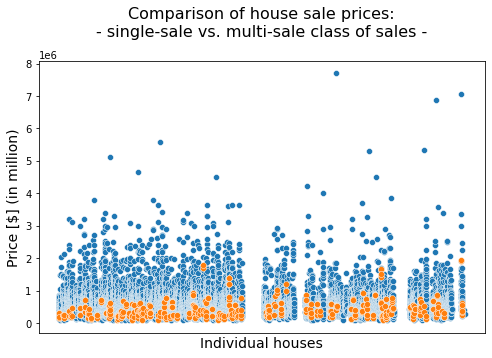

In [14]:
# Prices across all houses (sale ids were used here) are compared between both classes of sale:
# Scatterplot of ids and price plotted on top of each other for simple visualization
fig = sns.scatterplot(data= kd_single, x=kd_single['id'], y=kd_single['price'])
fig = sns.scatterplot(data= kd_multi, x=kd_multi['id'], y=kd_multi['price'])
fig.set(xticks=[])
fig.set(xticklabels=[])
fig.set_xlabel('Individual houses', size=14)
fig.set_title('Comparison of house sale prices:\n- single-sale vs. multi-sale class of sales -', pad = 25, size=16)
fig.set_ylabel('Price [$] (in million)', size =14)
plt.show()
# Due to the nature of the data this plot is already sufficient to illustrate the trent.

Orange: multi_sale houses<br>
Blue: single_sale houses<br>
Multi-sale houses are cheaper than single-sale houses.<br>
Where are the multi-sale houses located?
What is their condition?

In [15]:
# plot the location of multi-sale houses with coloration of the prize and the condition shown by size.
fig = px.scatter_mapbox(kd_multi, lat="lat", lon="long",
                        color='price', 
                        #opacity=0.9,
                        color_continuous_scale=px.colors.sequential.Greys, 
                        hover_name="grade",
                        size='condition',
                       # size_max=7,
                        zoom=8,
                        height=800)
fig.update_layout(mapbox_style="stamen-terrain")
#fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.show()
# "open-street-map", "carto-positron", "carto-darkmatter", "stamen-terrain", "stamen-toner" or "stamen-watercolor"

In [16]:
# Is the condition comparably low as compared to single-sale houses?
# Creating a dataset of medians for each feature. However, categorical features would require counting.
data = pd.concat([pd.DataFrame(kd_single.median().reset_index()),pd.DataFrame(kd_multi.median().reset_index())], axis=1).iloc[1:, 1:4]
data.set_axis(['features_single','feature_name','features_multi'], axis=1, inplace =True)
data


,features_single,feature_name,features_multi
1,451000.000,price,340000.000
2,3.000,bedrooms,3.000
3,2.250,bathrooms,1.750
4,1920.000,sqft_living,1600.000
5,7606.000,sqft_lot,7980.000
6,1.500,floors,1.000
7,0.000,waterfront,0.000
8,0.000,view,0.000
9,3.000,condition,3.000
10,7.000,grade,7.000


In [83]:
kd_multi.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,log_price
count,353.000,353.000,353.000,353.000,353.000,353.000,353.000,307.000,353.000,353.000,353.000,353.000,353.000,286.000,353.000,353.000,353.000,353.000,353.000,353.000
mean,4534695157.643,419655.850,3.283,1.803,1742.040,11650.040,1.266,0.000,0.136,3.297,7.074,1478.300,1959.734,55.371,98087.099,47.548,-122.238,1775.167,10660.856,18.411
std,2874363668.110,294695.878,1.028,0.736,756.404,22798.589,0.433,0.000,0.660,0.699,1.170,634.166,25.555,326.981,56.883,0.134,0.130,611.113,16444.017,0.858
min,1000102.000,82000.000,1.000,0.750,580.000,1092.000,1.000,0.000,0.000,1.000,5.000,580.000,1900.000,0.000,98001.000,47.273,-122.463,810.000,1334.000,16.323
25%,1974300020.000,235000.000,3.000,1.000,1220.000,5546.000,1.000,0.000,0.000,3.000,6.000,1050.000,1943.000,0.000,98034.000,47.461,-122.337,1360.000,6000.000,17.842
50%,4031000520.000,340000.000,3.000,1.750,1600.000,7980.000,1.000,0.000,0.000,3.000,7.000,1290.000,1959.000,0.000,98077.000,47.543,-122.284,1610.000,7920.000,18.375
75%,7409700215.000,525000.000,4.000,2.250,2080.000,10080.000,1.500,0.000,0.000,4.000,7.000,1720.000,1978.000,0.000,98133.000,47.674,-122.172,2020.000,9572.000,19.002
max,9834200885.000,1940000.000,6.000,4.500,5290.000,224442.000,3.000,0.000,4.000,5.000,12.000,4540.000,2013.000,1990.000,98199.000,47.774,-121.734,4060.000,183897.000,20.888


___We can derive multiple information from the two tables above.___<br>
* The median for both classes for the condition (3), grade (7) and bedrooms (3) is similar. This means on average, subtle renovations could be sufficient in most cases. 
* The area for living and of the lot is similar to the neighbors within both classes. <br>

___Potential indicators for a comparably poor area?___<br>
* The price is lower and thehouses are older in the multi-sale class.
* The area for living as compared to the single-sale class is less which could be due to the number of floors (1, vs 1.5 for single-sale houses). 
* Interestingly the lot area is larger for the multi-sale houses which could be a reason for selling and/or these are just an indicator that these are located in more rural areas of the city where there is more space per house available than in the city center, for example. 
* None of the multi-sale houses is at the water front which is more central and where houses are also more expensive.<br>

In [80]:
kd_single.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,log_price
count,21244.000,21244.000,21244.000,21244.000,21244.000,21244.000,21244.000,18914.000,21181.000,21244.000,21244.000,21244.000,21244.000,17469.000,21244.000,21244.000,21244.000,21244.000,21244.000,21244.000
mean,4581234974.691,542301.195,3.375,2.121,2085.943,15156.725,1.498,0.008,0.235,3.412,7.668,1793.753,1971.187,84.100,98077.800,47.560,-122.214,1990.134,12793.135,18.831
std,2876836559.714,368126.454,0.924,0.768,919.517,41649.627,0.540,0.088,0.767,0.650,1.171,829.627,29.399,401.022,53.443,0.139,0.141,685.857,27417.179,0.756
min,1200019.000,78000.000,1.000,0.500,370.000,520.000,1.000,0.000,0.000,1.000,3.000,370.000,1900.000,0.000,98001.000,47.156,-122.519,399.000,651.000,16.251
25%,2124049247.750,324950.000,3.000,1.750,1430.000,5040.000,1.000,0.000,0.000,3.000,7.000,1200.000,1952.000,0.000,98033.000,47.471,-122.328,1490.000,5100.000,18.310
50%,3904921025.000,451000.000,3.000,2.250,1920.000,7606.000,1.500,0.000,0.000,3.000,7.000,1570.000,1975.000,0.000,98065.000,47.572,-122.229,1840.000,7620.000,18.783
75%,7308600042.500,647125.000,4.000,2.500,2557.750,10697.250,2.000,0.000,0.000,4.000,8.000,2220.000,1997.000,0.000,98117.000,47.678,-122.124,2370.000,10089.000,19.304
max,9900000190.000,7700000.000,33.000,8.000,13540.000,1651359.000,3.500,1.000,4.000,5.000,13.000,9410.000,2015.000,2015.000,98199.000,47.778,-121.315,6210.000,871200.000,22.876


In [79]:
kd_multi.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 353 entries, 6021501535 to 7853420110
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             353 non-null    int64  
 1   date           353 non-null    object 
 2   price          353 non-null    float64
 3   bedrooms       353 non-null    int64  
 4   bathrooms      353 non-null    float64
 5   sqft_living    353 non-null    int64  
 6   sqft_lot       353 non-null    int64  
 7   floors         353 non-null    float64
 8   waterfront     307 non-null    float64
 9   view           353 non-null    float64
 10  condition      353 non-null    int64  
 11  grade          353 non-null    int64  
 12  sqft_above     353 non-null    int64  
 13  sqft_basement  353 non-null    object 
 14  yr_built       353 non-null    int64  
 15  yr_renovated   286 non-null    float64
 16  zipcode        353 non-null    int64  
 17  lat            353 non-null    float64

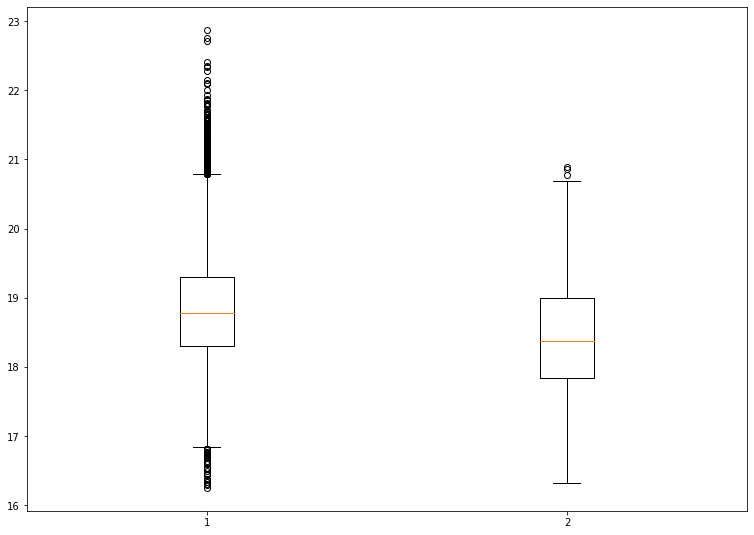


Descriptive statistics for the single-sale homes:

count     21244.000
mean     542301.195
std      368126.454
min       78000.000
25%      324950.000
50%      451000.000
75%      647125.000
max     7700000.000
Name: price, dtype: float64

Descriptive statistics for the multi-sale homes:

count       353.000
mean     419655.850
std      294695.878
min       82000.000
25%      235000.000
50%      340000.000
75%      525000.000
max     1940000.000
Name: price, dtype: float64

The median price of single-sale homes' is: 451000
The median price of multi-sale homes' is: 340000
The mode price of single-sale homes' prices is: 450000
The mode price of multi-sale homes' prices is: 430000


In [80]:
#Preparing the data for boxplots comparing single and multi sale homes' prices:
#data = [kd_single['price'], kd_multi['price']]
# log2 was initially calculated as still shown in the code below. As we now added a log_price column, we could also now access this column here.
data = [np.log2(kd_single['price']).tolist(), np.log2(kd_multi['price']).tolist()]

fig = plt.figure(figsize = (10,7))
ax = fig.add_axes([0,0,1,1])
bp = ax.boxplot(data)
plt.show()

# Adjust decimal to 3
import statistics
print("\nDescriptive statistics for the single-sale homes:\n")
print(kd_single['price'].describe())
print("\nDescriptive statistics for the multi-sale homes:\n")
print(kd_multi['price'].describe())
print(f"\nThe median price of single-sale homes' is: {int(kd_single['price'].median())}")
print(f"The median price of multi-sale homes' is: {int(kd_multi['price'].median())}")
print(f"The mode price of single-sale homes' prices is: {int(statistics.mode(kd_single['price']))}")
print(f"The mode price of multi-sale homes' prices is: {int(statistics.mode(kd_multi['price']))}")

___Conclusions from the table above___
* Often old houses are expensive with respect to renovation but also might be cheaper in prize. 
* Taken together this could be houses which are bought by people on comparable poorer neighborhoods or just got too expensive for their owners also in the middle class of incomes.
* To test this, we inspect the respective boxplots.
* These boxplots were also inspected for other conclusions within this notebook prior to deciding on the data to present.

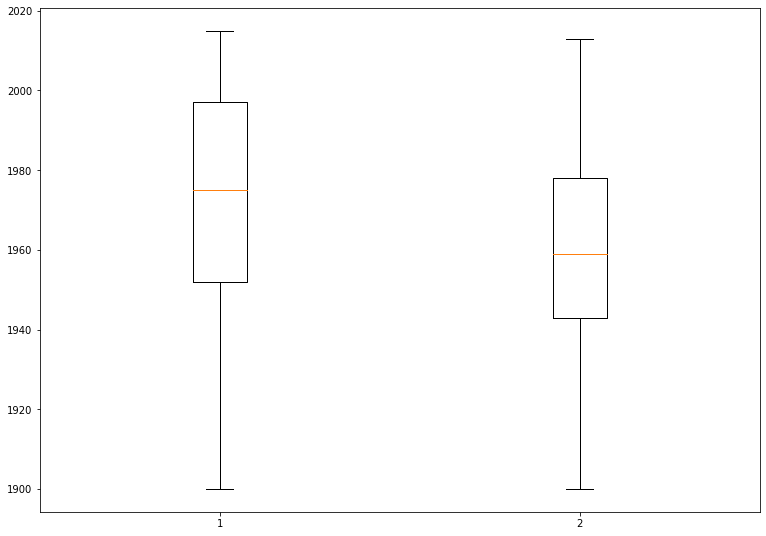


Descriptive statistics for the single-sale homes:

count   21244.000
mean     1971.187
std        29.399
min      1900.000
25%      1952.000
50%      1975.000
75%      1997.000
max      2015.000
Name: yr_built, dtype: float64

The median building years of single-sale homes is: 1975
The mode of the building years of single-sale homes is: 2014

Descriptive statistics for the single-sale homes is:

count    353.000
mean    1959.734
std       25.555
min     1900.000
25%     1943.000
50%     1959.000
75%     1978.000
max     2013.000
Name: yr_built, dtype: float64

The median building years of multi-sale homes: 1959
The mode of the building years of multi-sale homes is: 1956


In [82]:
#Preparing the data for the boxplot comparing single and multi sale homes' prices:
data = [kd_single['yr_built'].dropna(), kd_multi['yr_built'].dropna()]

fig = plt.figure(figsize = (10,7))
ax = fig.add_axes([0,0,1,1])
bp = ax.boxplot(data)
plt.show()

print("\nDescriptive statistics for the single-sale homes:\n")
print(kd_single['yr_built'].describe())
print(f"\nThe median building years of single-sale homes is: {int(kd_single['yr_built'].median())}")
print(f"The mode of the building years of single-sale homes is: {statistics.mode(kd_single['yr_built'])}")

print("\nDescriptive statistics for the single-sale homes is:\n")
print(kd_multi['yr_built'].describe())
print(f"\nThe median building years of multi-sale homes: {int(kd_multi['yr_built'].median())}")
print(f"The mode of the building years of multi-sale homes is: {statistics.mode(kd_multi['yr_built'])}")

In [14]:
# Another ideas incubator box....
# I could include a multi_sale id and split the two sales of one home_id into two events. 
# For each sale_id the price of the earliest sale is substracted from the latest sale and we plot the profit or loss, respectively by month of buying and month of sale for sale_id and by the time expired between buying and saling the home. 
# We also want to know if the groups of sale_ids for which a renovation occurred  within this period or within a period of five years before the home was bought show a different gain-loss pattern.
#   -> This idea is not followed as the number of renovated homes within this group is too low (4 of 176)
# Eventually we plot the houses within Seattle to see if the multi_sale homes are clustering in a certain area (center vs suburb or zip codes).

In [83]:
# With this chunk of code the respective unique entries and their writing can be inspected 
# either for all or for selected columns only without the loop and specific selection of the respective column of interest.
# However, this is only usefull for a very first assessment of the data and to find spelling differences as compared to expected entries or similar.

# for i in range(0,(kd.shape[1])):
#    print(kd.iloc[:,i].unique())

# For the question on the format of the data we can get the answer as follows:
print(kd['date'].head())
kd.date = pd.to_datetime(kd.date)
kd['year'] = pd.to_datetime(kd.date).dt.year
kd['month'] = pd.to_datetime(kd.date).dt.month
kd['month_day'] = pd.DataFrame(kd['date'].dt.strftime('%m-%d'))
kd.head()
kd.info()


0    10/13/2014
1     12/9/2014
2     2/25/2015
3     12/9/2014
4     2/18/2015
Name: date, dtype: object
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 25 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             21597 non-null  int64         
 1   date           21597 non-null  datetime64[ns]
 2   price          21597 non-null  float64       
 3   bedrooms       21597 non-null  int64         
 4   bathrooms      21597 non-null  float64       
 5   sqft_living    21597 non-null  int64         
 6   sqft_lot       21597 non-null  int64         
 7   floors         21597 non-null  float64       
 8   waterfront     19221 non-null  float64       
 9   view           21534 non-null  float64       
 10  condition      21597 non-null  int64         
 11  grade          21597 non-null  int64         
 12  sqft_above     21597 non-null  int64         
 13  sqft_basement  

In [84]:
# Back to the maps. Is there a pattern for the year of sale? 

kd['log_price'] = np.log2(kd['price']).tolist()
# scatter_mapbox
fig = px.scatter_mapbox(kd, lat="lat", lon="long",
                        color='year', 
                        #opacity=0.9,
                        color_continuous_scale=px.colors.sequential.Greys_r, 
                        #hover_name="yr_renovated",
                        #size='condition',
                        size_max=7,
                        zoom=8,
                        height=800)
fig.update_layout(mapbox_style="open-street-map")
#fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.show()
# "open-street-map", "carto-positron", "carto-darkmatter", "stamen-terrain", "stamen-toner" or "stamen-watercolor"

No, there is no obvious pattern  by the year.
What about the month?

In [23]:

kd['log_price'] = np.log2(kd['price']).tolist()
# scatter_mapbox
fig = px.scatter_mapbox(kd, lat="lat", lon="long",
                        color='log_price', 
                        #opacity=0.9,
                        color_continuous_scale=px.colors.sequential.Greys, 
                        #hover_name="yr_renovated",
                        #size='condition',
                        size_max=7,
                        zoom=8,
                        height=800)
fig.update_layout(mapbox_style="open-street-map")
#fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.show()
# "open-street-map", "carto-positron", "carto-darkmatter", "stamen-terrain", "stamen-toner" or "stamen-watercolor"

No, again nor obvious pattern. This means the data is well distributed across years and month. Now we can plot the price against the month_day for a high resolution and than month per year to get an idea about general changes of the price over the year. However, when narrowing down this dataset, it might be required to analyze this again for the subset of data.

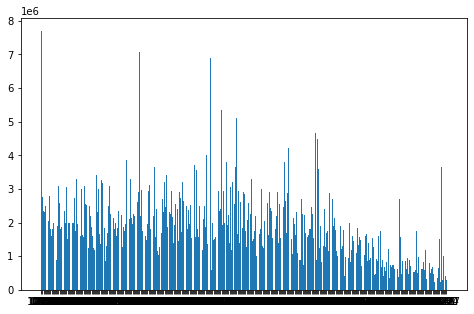

In [86]:
plt.bar(x= kd['month_day'], height= kd['price'])
labels = kd['month'].unique()
grouped_year = kd.groupby('year')
price_month_2014 = grouped_year.get_group(2014)[['price', 'month']]
price_month_2015 = grouped_year.get_group(2015)[['price', 'month']]

#x: month_day
#y: price [$]


We see that there are from time to time specific objects with a high price, these might need a specific treatment, however, here we will concentrate on poor neighborhoods in which we assume the house prices to be at least below the median.

month
5     AxesSubplot(0.125,0.125;0.775x0.755)
6     AxesSubplot(0.125,0.125;0.775x0.755)
7     AxesSubplot(0.125,0.125;0.775x0.755)
8     AxesSubplot(0.125,0.125;0.775x0.755)
9     AxesSubplot(0.125,0.125;0.775x0.755)
10    AxesSubplot(0.125,0.125;0.775x0.755)
11    AxesSubplot(0.125,0.125;0.775x0.755)
12    AxesSubplot(0.125,0.125;0.775x0.755)
Name: price, dtype: object

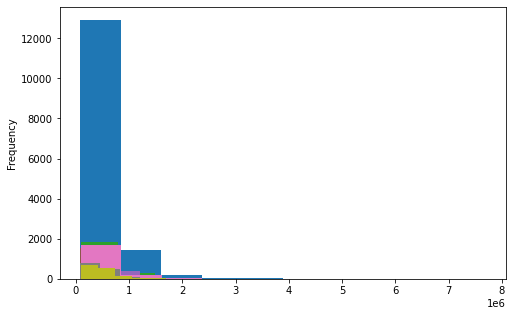

In [87]:
price_month_2014['price'].plot(kind='hist')
price_month_2014.groupby('month')['price'].plot(kind = 'hist')
#x: price [$]

month
1    AxesSubplot(0.125,0.125;0.775x0.755)
2    AxesSubplot(0.125,0.125;0.775x0.755)
3    AxesSubplot(0.125,0.125;0.775x0.755)
4    AxesSubplot(0.125,0.125;0.775x0.755)
5    AxesSubplot(0.125,0.125;0.775x0.755)
Name: price, dtype: object

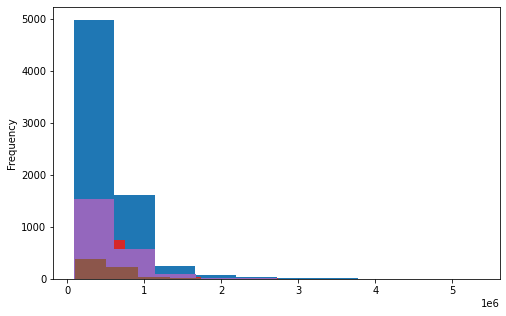

In [88]:
price_month_2015['price'].plot(kind='hist')
price_month_2015.groupby('month')['price'].plot(kind = 'hist')
#x: price [$]

### As the histograms from above are not really helpful, we do something similar with plotly also indicating where individual data points are in this right skewed distribution. Note that the counts per year are added and the count per year becomes visible when hovering over the plot only. As expected, The counts for 2014 are higher as there is data from May to December while for 2015 we only have data from January to May.

In [89]:
import plotly.express as px
df = kd
fig = px.histogram(df, x="price", color="year", marginal="rug", # can be `box`, `violin`
                         hover_data=df.columns)
fig.show()

In [90]:
# In this histogram, all data per month are added according to the color-coded order
# import plotly.express as px
df = kd
fig = px.histogram(df, x="price", color="month", marginal="rug", # can be `box`, `violin`
                         hover_data=df.columns)
fig.show()

Eventually we compare May in 2014 with 2015, the only month with data from two years.

In [91]:
df = kd.query('month==5')
fig = px.histogram(df, x="price", color="year", marginal="rug", # can be `box`, `violin`
                         hover_data=df.columns)
fig.show()

In [92]:
# Median and mean price and other stats for 2014 and 2015 by month
print('Prices in 2014')
print(pd.concat([pd.DataFrame(price_month_2015.groupby('month').median()),pd.DataFrame(price_month_2015.groupby('month').mean())], axis=1, keys = ['prices_median','prices_mean']))
print('Prices in 2015')
print(pd.concat([pd.DataFrame(price_month_2014.groupby('month').median()),pd.DataFrame(price_month_2014.groupby('month').mean())], axis=1, keys = ['prices_median','prices_mean']))

Prices in 2014
      prices_median prices_mean
              price       price
month                          
1        438500.000  525963.252
2        426500.000  508520.051
3        450000.000  544057.683
4        477000.000  562215.615
5        455000.000  558193.096
Prices in 2015
      prices_median prices_mean
              price       price
month                          
5        465000.000  548166.600
6        465000.000  557534.318
7        465000.000  544892.161
8        442200.000  536655.212
9        450000.000  529723.518
10       447000.000  539439.447
11       435000.000  522359.903
12       432500.000  524799.902


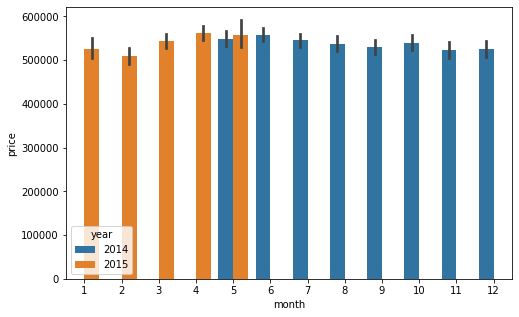

In [93]:
# The seaborn barplot plots the means and the standarddeviation
sns.barplot(data=kd,x='month',y='price', hue='year')
plt.show()

# Again, here is a plot for May 2014 and 2015

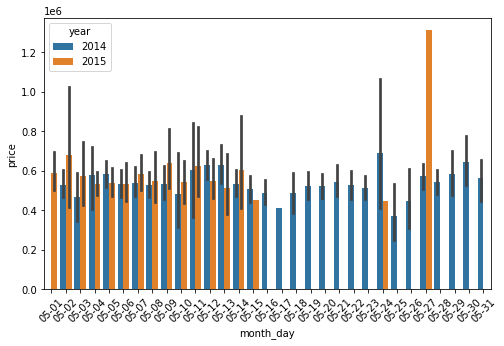

Statistic information for May 2014:
                  id       price  bedrooms  bathrooms  sqft_living  \
count       1768.000    1768.000  1768.000   1768.000     1768.000   
mean  4628282467.141  548166.600     3.390      2.140     2114.913   
std   2920126215.542  356697.007     0.918      0.795      975.136   
min      1200019.000   78000.000     1.000      0.750      430.000   
25%   2011300562.500  325975.000     3.000      1.750     1430.000   
50%   4012800030.000  465000.000     3.000      2.250     1945.000   
75%   7443501128.750  650910.000     4.000      2.500     2600.000   
max   9839300875.000 3710000.000     9.000      8.000    13540.000   

         sqft_lot   floors  waterfront     view  condition  ...  yr_built  \
count    1768.000 1768.000    1589.000 1762.000   1768.000  ...  1768.000   
mean    15959.428    1.493       0.006    0.245      3.436  ...  1970.537   
std     43043.924    0.548       0.079    0.778      0.671  ...    29.689   
min       681.000    1.00

In [94]:
df = kd.query('month==5').sort_values('month_day')
sns.barplot(data=df,x='month_day',y='price', hue='year')
plt.xticks(rotation=45)
plt.show()

print("Statistic information for May 2014:")

print(df[df['year']==2014].describe())

print("\nStatistic information for May 2015:")

print(df[df['year']==2015].describe())

It might be that the data in 2015 between mid of May and end of May is incomplete. However, there is no strong trend between the years within the first half of May. We can assume that during 2014 there was no overall surprising shift in prices. When we look a bit more into the details, the mean, min and max point to an increase over time as expected as the population in this area is also constantly increasing which can be expected to result in an increase in demand. However, more data would be needed to support this trend which is not available for now. <br>
<br>
A better dataset would include data from more than one year. This would provide a safer basis for recommendations for the stakeholders.

In [95]:
# Is the period exactly one year or is there an overlap in May?
kd.date.min(), kd.date.max()

# There are 25 days of overlap for May, so May is the only month with overlapping data from two years.
# Statements relative to the timing are not very well supported as there might have been specific events in 2014 and/or 2015.
# This needs to be underlined when suggesting a specific month to be optimal for selling or buying depending on the price.

(Timestamp('2014-05-02 00:00:00'), Timestamp('2015-05-27 00:00:00'))

<AxesSubplot:>

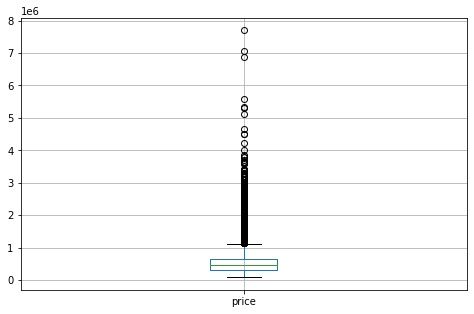

In [96]:
# Are there outliers? This is checked here with a box plot and can be selected by column number while exploring the data, select for which plots a log transformation is required.
kd.iloc[:,2].plot.box(grid='True')


### Most prices are below $ 1,000,000 as also seen on the geographic map initially.

<AxesSubplot:>

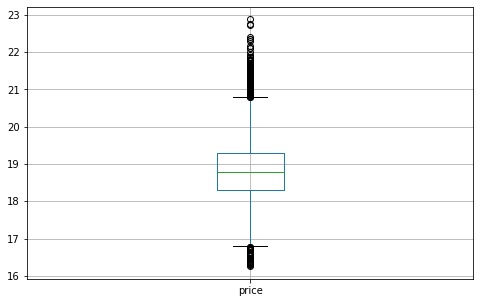

In [97]:
# Her log2 is plotted per selectde column as this is advisable for some features. Such columns were collected in the list log_columns
log_columns = [2,3,4,5,6,12,19,20]
np.log2(kd.iloc[:,2]).plot.box(grid='True')

# Now get hands on question 2:
* Get the gain loss per multi-sale house

In [166]:
#multi-sales2 (2 sales within one year)
kd_multi2 = kd.query('id_counts == 2').reset_index()
kd_multi2 
#px.scatter_3d(kd_multi2, x='id', y='date',z='price')

,index,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,...,zipcode,lat,long,sqft_living15,sqft_lot15,log_price,year,month,month_day,id_counts
0,1000102,1000102,2014-09-16,280000.000,6,3.000,2400,9373,2.000,NaN,...,98002,47.326,-122.214,2060,7316,18.095,2014,9,09-16,2
1,1000102,1000102,2015-04-22,300000.000,6,3.000,2400,9373,2.000,0.000,...,98002,47.326,-122.214,2060,7316,18.195,2015,4,04-22,2
2,7200179,7200179,2014-10-16,150000.000,2,1.000,840,12750,1.000,0.000,...,98055,47.484,-122.211,1480,6969,17.195,2014,10,10-16,2
3,7200179,7200179,2015-04-24,175000.000,2,1.000,840,12750,1.000,0.000,...,98055,47.484,-122.211,1480,6969,17.417,2015,4,04-24,2
4,109200390,109200390,2014-08-20,245000.000,3,1.750,1480,3900,1.000,0.000,...,98023,47.298,-122.367,1830,6956,17.902,2014,8,08-20,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
345,9828200460,9828200460,2015-01-06,430000.000,2,1.000,700,4800,1.000,0.000,...,98122,47.615,-122.300,1440,4800,18.714,2015,1,01-06,2
346,9834200305,9834200305,2014-07-16,350000.000,3,1.000,1790,3876,1.500,0.000,...,98144,47.575,-122.288,1360,4080,18.417,2014,7,07-16,2
347,9834200305,9834200305,2015-02-10,615000.000,3,1.000,1790,3876,1.500,0.000,...,98144,47.575,-122.288,1360,4080,19.230,2015,2,02-10,2
348,9834200885,9834200885,2014-07-17,360000.000,4,2.500,2080,4080,1.000,0.000,...,98144,47.572,-122.290,1340,4080,18.458,2014,7,07-17,2


In [ ]:
# get a function to get the gain or loss per sale
def x(df):
    i=1
    df.iloc[i,'id']

In [202]:
def x(df,ID):
    df_ID = df[df['id']==ID]
    df_max = df_ID['date'].max()
    df_min = df_ID['date'].min()
    result = df_ID[df_ID['date']==df_max]['price'].iloc[0] - df_ID[df_ID['date']==df_min]['price'].iloc[0]
    return result

In [211]:
multi2_ID = kd_multi2['id'].unique().tolist()
price_span_multi = [x(kd_multi2,ID) for ID in multi2_ID]

# define a function for calculating the win per multi-sale house
def x(df,ID):
    df_ID = df[df['id']==ID]
    df_max = df_ID['date'].max()
    df_min = df_ID['date'].min()
    result = df_ID[df_ID['date']==df_max]['price'].iloc[0] - df_ID[df_ID['date']==df_min]['price'].iloc[0]
    return result

# Create a dataframe from this
kd_price_span_multi = pd.DataFrame({'id': multi2_ID, 'price_span_multi': price_span_multi})
#and plot the win in $ per multi-sale house

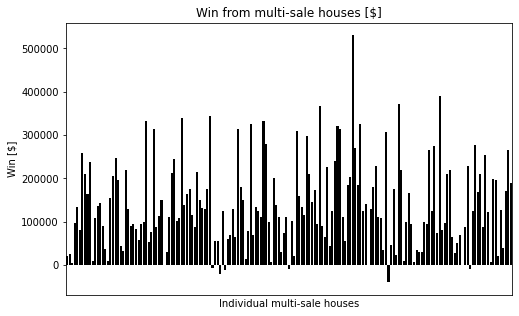

Median win: 122300.0


count      175.000
mean    137108.006
std     100405.113
min     -40000.000
25%      65000.000
50%     122300.000
75%     200000.000
max     529950.000
Name: price_span_multi, dtype: float64

In [249]:
fig = sns.barplot(data=kd_price_span_multi, x='id',y='price_span_multi', color='black')
fig.set(xticks=[])
fig.set(xticklabels=[])
fig.set(xlabel='Individual multi-sale houses')
fig.set(title='Win from multi-sale houses [$]')
fig.set(ylabel='Win [$]')
plt.show()
print(f"Median win: {(kd_price_span_multi['price_span_multi'].median())}")
kd_price_span_multi['price_span_multi'].describe()

# Answer
Indeed, multi-sale houses are suitable for renovations. The median win is $122,300. Therefor, I would suggest to invest not more than 0.6*122300 in renovations. As the maximal loss was $40,000 and renovations can be expected to increase the value of the house, this is conservative in risk and allows for a positive social footprint when buying renovating and selling multiple of such houses.
Note, also that multi-sale houses have a similar grade and as single sale houses. They usually have only one floor and less sqrt of living area as compared to single-sale houses. If more living space can be generated by the available amount of money this might be beneficial. The latter statements are extracted from a table genrated above. See also below for a recap.


In [250]:
# Comaprison of features between single- and multi-sale houses.
# Categorical data can be removed as it is not infomrative here. In the future, a relative count result from this data type can be added to the analysis.
print("Median per feature and sale-type:")
data = pd.concat([pd.DataFrame(kd_single.median().reset_index()),pd.DataFrame(kd_multi.median().reset_index())], axis=1).iloc[1:, 1:4]
data.set_axis(['features_single','feature_name','features_multi'], axis=1, inplace =True)
data

Median per feature and sale-type:


,features_single,feature_name,features_multi
1,451000.000,price,340000.000
2,3.000,bedrooms,3.000
3,2.250,bathrooms,1.750
4,1920.000,sqft_living,1600.000
5,7606.000,sqft_lot,7980.000
6,1.500,floors,1.000
7,0.000,waterfront,0.000
8,0.000,view,0.000
9,3.000,condition,3.000
10,7.000,grade,7.000


# ___Outlook:___

* It can be assumed that there is a general increase of house prices in the whole area. In particular in southern regions as grouped by zip code one could follow the development of prices over time (per month) using the full dataset as well as the multi-sale dataset. As the latter is comparably small, the full dataset should be preferred for conclusions.
* Another positive aspect about knowing about these multi-sale houses is that it was possible to sell these again within one year and, therefore, these houses and those in their neighborhood are interesting objects to invest in. 
* More focus could be layed on the those neighborhoods which are poorer than the average multi-sale areas. However, being more confident about the recommendation for the stakeholder was prioritized above risk and therefore the available price increases were used as a basis. As this stakeholder works with comparably low gains, the risk should be minimized. 
* To support this stakeholder to succeed against competitors with less social strategies, one could do correlation analysis with feature vectors of numerical and count data for all houses, single-sale houses and multi-sale houses in the whole area and also in poorer areas as defined by 33% of the lowest prices from all houses in the datasets. This way one could try to identify houses that belong to the same class, located in at least comparably poorer neighborhoods and might be easily sold within a short time frame.
* One has to admit that the medium price for a house in the discussed multi-sale class of sales is low but not very low ($340,000). A really poor neighborhood might be better defined by even going below this price.